In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from clawpack import pyclaw

In [2]:
from matplotlib import animation
from clawpack.visclaw.JSAnimation import IPython_display

def plot_surface(claw,ylim=None,save_plots=False,frames=101,val='surface',vmin=0.,vmax=0.5,
                 clim=None):
    fig = plt.figure(figsize=[10,10])
    ax1 = fig.add_subplot(111)
    try:
        frame = claw.frames[0]
    except:
        frame = pyclaw.Solution(0,read_aux=False)
    b = 0.
    h = frame.q[0,:,:]
    if val == 'surface':
        qq = np.maximum(b,h+b)
    elif val=='u':
        hu = frame.q[1,:,:]
        qq = hu/h
        

    x, y = frame.state.grid.p_centers    

    im = ax1.imshow(qq.T, #cmap='Blues',
                    extent=[x.min(), x.max(), y.min(), y.max()],
                    vmin=vmin, vmax=vmax,
                    interpolation='nearest', origin='lower')
                    
    plt.colorbar(im)
    def fplot(frame_number):
        try:
            frame = claw.frames[frame_number]
        except:
            frame = pyclaw.Solution(frame_number,read_aux=False)
        h = frame.q[0,:,:]
        if val == 'surface':
            qq = np.maximum(b,h+b)
        elif val=='u':
            hu = frame.q[1,:,:]
            qq = hu/h
        surface = h+b
        im.set_data(qq.T)
        if clim:
            im.set_clim(*clim)
        return im,

    return animation.FuncAnimation(fig, fplot, frames=frames, interval=40)

In [3]:
def set_jet_values(solver,state):
    xc, yc = state.p_centers
    rc = np.sqrt(xc**2 + yc**2)
    r0 = state.problem_data['r0']
    h0 =  state.problem_data['h0']
    u0 =  state.problem_data['u0']

    in_jet = np.where(rc<r0)
    
    state.q[0,in_jet[0],in_jet[1]] = h0
    state.q[1,in_jet[0],in_jet[1]] = h0*u0*xc[in_jet]/(rc[in_jet]+1.e-7)
    state.q[2,in_jet[0],in_jet[1]] = h0*u0*yc[in_jet]/(rc[in_jet]+1.e-7)

def subsonic_boundary_lower(state,dim,t,qbc,auxbc,num_ghost):
    "Subsonic outflow at fixed Froude number"
    xc, yc = state.grid.p_centers_with_ghost(num_ghost)
    rc = np.sqrt(xc**2 + yc**2)
    r0 = state.problem_data['r0']
    h0 =  state.problem_data['h0']
    u0 =  state.problem_data['u0']
    beta = r0*h0*u0
    F = state.problem_data['F_bdy'] # Froude number at boundary
    g = state.problem_data['grav']
    
    h = (beta/(rc*F*np.sqrt(g)))**(2./3)
    unorm = beta / (rc*h)
    
    if dim.name == 'x':
        qbc[0,:num_ghost,:] = h[:num_ghost,:]
        qbc[1,:num_ghost,:] = h[:num_ghost,:]*unorm[:num_ghost,:]*xc[:num_ghost,:]/rc[:num_ghost,:]
        qbc[2,:num_ghost,:] = h[:num_ghost,:]*unorm[:num_ghost,:]*yc[:num_ghost,:]/rc[:num_ghost,:]       
    elif dim.name == 'y':
        qbc[0,:,:num_ghost] = h[:,:num_ghost]
        qbc[1,:,:num_ghost] = h[:,:num_ghost]*unorm[:,:num_ghost]*xc[:,:num_ghost]/rc[:,:num_ghost]
        qbc[2,:,:num_ghost] = h[:,:num_ghost]*unorm[:,:num_ghost]*yc[:,:num_ghost]/rc[:,:num_ghost]

def subsonic_boundary_upper(state,dim,t,qbc,auxbc,num_ghost):
    "Subsonic outflow at fixed Froude number"
    xc, yc = state.grid.p_centers_with_ghost(num_ghost)
    rc = np.sqrt(xc**2 + yc**2)
    r0 = state.problem_data['r0']
    h0 =  state.problem_data['h0']
    u0 =  state.problem_data['u0']
    beta = r0*h0*u0
    F = state.problem_data['F_bdy'] # Froude number at boundary
    g = state.problem_data['grav']
    
    h = (beta/(rc*F*np.sqrt(g)))**(2./3)
    unorm = beta / (rc*h)
    
    if dim.name == 'x':
        qbc[0,-num_ghost:,:] = h[-num_ghost:,:]
        qbc[1,-num_ghost:,:] = h[-num_ghost:,:]*unorm[-num_ghost:,:]*xc[-num_ghost:,:]/rc[-num_ghost:,:]
        qbc[2,-num_ghost:,:] = h[-num_ghost:,:]*unorm[-num_ghost:,:]*yc[-num_ghost:,:]/rc[-num_ghost:,:]     
    elif dim.name == 'y':
        qbc[0,:,-num_ghost:] = h[:,-num_ghost:]
        qbc[1,:,-num_ghost:] = h[:,-num_ghost:]*unorm[:,-num_ghost:]*xc[:,-num_ghost:]/rc[:,-num_ghost:]
        qbc[2,:,-num_ghost:] = h[:,-num_ghost:]*unorm[:,-num_ghost:]*yc[:,-num_ghost:]/rc[:,-num_ghost:]
    else:
        raise Exception(dim)
        
        
def setup(h0,u0,g=1.,num_cells=100,tfinal=1,solver_type='classic',
          num_output_times=10,riemann_solver='hlle',outdir='_output'):
    
    from clawpack import riemann
    from clawpack import pyclaw

    if solver_type == 'classic':
        if riemann_solver == 'hlle':
            solver = pyclaw.ClawSolver2D(riemann.shallow_hlle_2D)
            solver.fwave = False
        else:
            solver = pyclaw.ClawSolver2D(riemann.sw_aug_2D)
            solver.fwave = True
        #solver.dimensional_split=True
        #solver.limiters = pyclaw.limiters.tvd.minmod
        solver.cfl_max     = 0.9
        solver.cfl_desired = 0.8
        solver.transverse_waves = 2
    elif solver_type == 'sharpclaw':
        if riemann_solver == 'hlle':
            solver = pyclaw.SharpClawSolver2D(riemann.shallow_hlle_2D)
        else:
            solver = pyclaw.SharpClawSolver2D(riemann.sw_aug_2D)
            

    solver.bc_lower[0] = pyclaw.BC.custom
    solver.bc_upper[0] = pyclaw.BC.custom
    solver.bc_lower[1] = pyclaw.BC.custom
    solver.bc_upper[1] = pyclaw.BC.custom
    solver.user_bc_lower = subsonic_boundary_lower
    solver.user_bc_upper = subsonic_boundary_upper

    solver.before_step = set_jet_values


    # Domain:
    xlower = -1;  xupper =  1.
    ylower = -1;  yupper =  1.

    mx = num_cells
    my = num_cells

    x = pyclaw.Dimension(xlower,xupper,mx,name='x')
    y = pyclaw.Dimension(ylower,yupper,my,name='y')
    domain = pyclaw.Domain([x,y])

    if riemann_solver == 'hlle':
        state = pyclaw.State(domain,3)
    else:
        state = pyclaw.State(domain,3,1)
        solver.aux_bc_lower[0] = pyclaw.BC.extrap
        solver.aux_bc_upper[0] = pyclaw.BC.extrap
        solver.aux_bc_lower[1] = pyclaw.BC.extrap
        solver.aux_bc_upper[1] = pyclaw.BC.extrap
    
    xc, yc = state.p_centers
    rc = np.sqrt(xc**2 + yc**2)
    r0 = 0.1
    
    if riemann_solver != 'hlle':
        state.aux[0,:,:] = 0.
    
    state.problem_data['r0'] = r0
    state.problem_data['h0'] = h0
    state.problem_data['u0'] = u0
    state.problem_data['grav'] = g   # Gravitational force
    state.problem_data['F_bdy'] = 0.1

    state.q[0,:,:] = (rc<r0)*h0 + (rc>=r0)*0.15
    state.q[1,:,:] = (rc<r0)*h0*u0*xc/(rc+1.e-7)
    state.q[2,:,:] = (rc<r0)*h0*u0*yc/(rc+1.e-7)


    #===========================================================================
    # Set up controller and controller parameters
    #===========================================================================
    claw = pyclaw.Controller()
    claw.tfinal = tfinal
    claw.solution = pyclaw.Solution(state,domain)
    claw.solver = solver
    claw.num_output_times = num_output_times
    claw.outdir=outdir
    if num_cells < 400:
        claw.keep_copy = True
        #claw.output_format = None
    else:
        claw.keep_copy = False

    return claw

In [9]:
rs = 'roe'
solver_type='classic'
mx = 200

outdir = rs+'_'+solver_type+'_'+str(mx)
claw = setup(0.5,0.75,tfinal=50,num_output_times=100,num_cells=mx,solver_type=solver_type,
             riemann_solver=rs,outdir=outdir)
#claw.verbosity=0
claw.run()

2018-11-25 18:46:43,798 INFO CLAW: Solution 0 computed for time t=0.000000
2018-11-25 18:46:46,917 INFO CLAW: Solution 1 computed for time t=0.500000
2018-11-25 18:46:49,682 INFO CLAW: Solution 2 computed for time t=1.000000
2018-11-25 18:46:52,361 INFO CLAW: Solution 3 computed for time t=1.500000
2018-11-25 18:46:55,355 INFO CLAW: Solution 4 computed for time t=2.000000
2018-11-25 18:46:58,252 INFO CLAW: Solution 5 computed for time t=2.500000
2018-11-25 18:47:01,057 INFO CLAW: Solution 6 computed for time t=3.000000
2018-11-25 18:47:04,016 INFO CLAW: Solution 7 computed for time t=3.500000
2018-11-25 18:47:06,937 INFO CLAW: Solution 8 computed for time t=4.000000
2018-11-25 18:47:09,643 INFO CLAW: Solution 9 computed for time t=4.500000
2018-11-25 18:47:12,453 INFO CLAW: Solution 10 computed for time t=5.000000
2018-11-25 18:47:15,164 INFO CLAW: Solution 11 computed for time t=5.500000
2018-11-25 18:47:18,020 INFO CLAW: Solution 12 computed for time t=6.000000
2018-11-25 18:47:20,93

{'cflmax': 0.8220612549519801,
 'dtmin': 0.0014140241493983399,
 'dtmax': 0.0054942437409830945,
 'numsteps': 9732}

2018-11-21 13:46:20,557 INFO CLAW: Animation.save using <class 'clawpack.visclaw.JSAnimation.html_writer.HTMLWriter'>



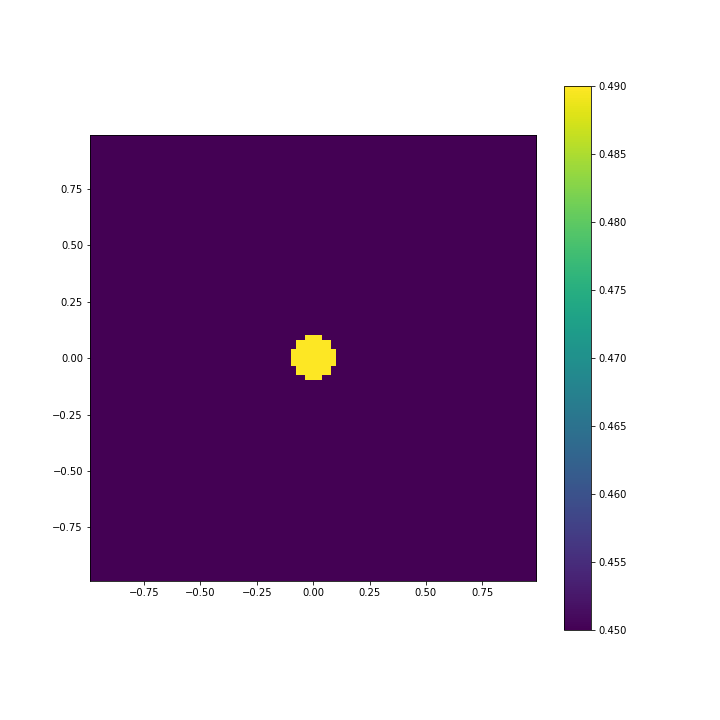
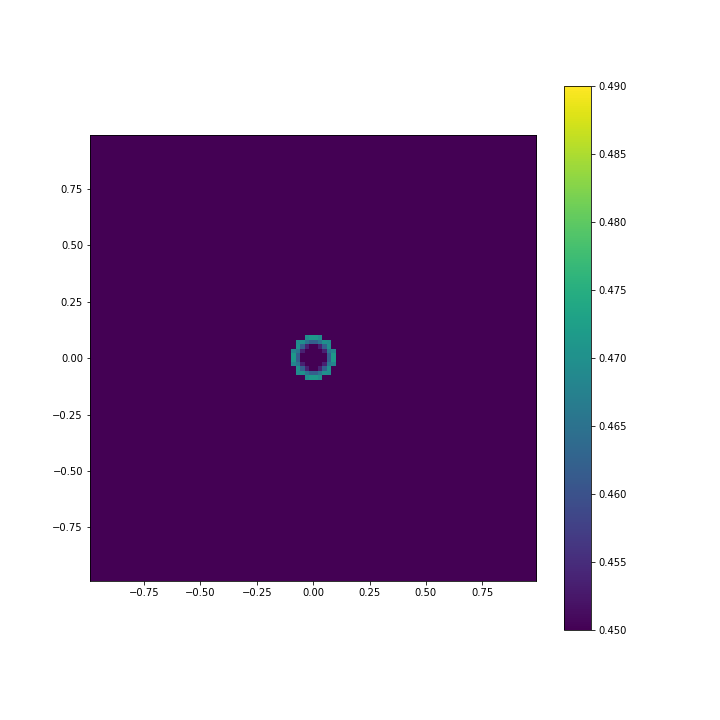
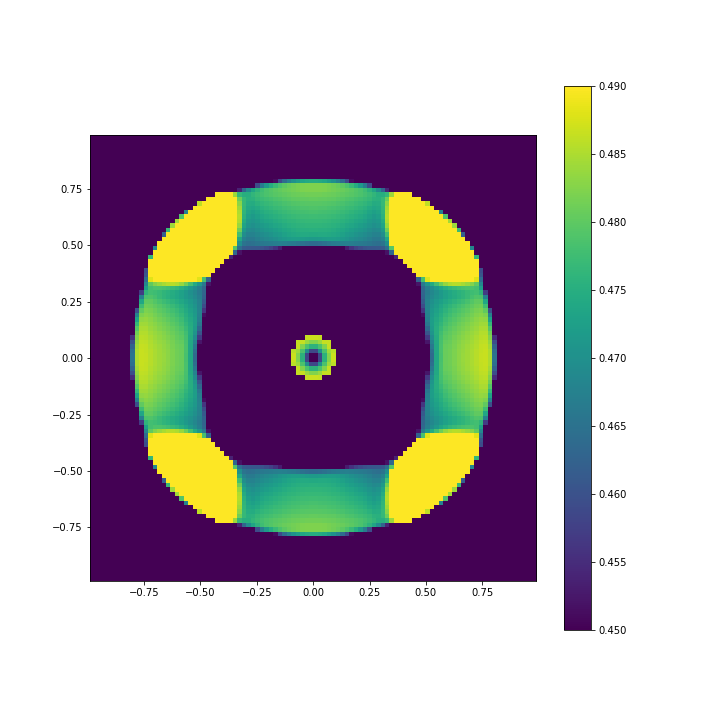
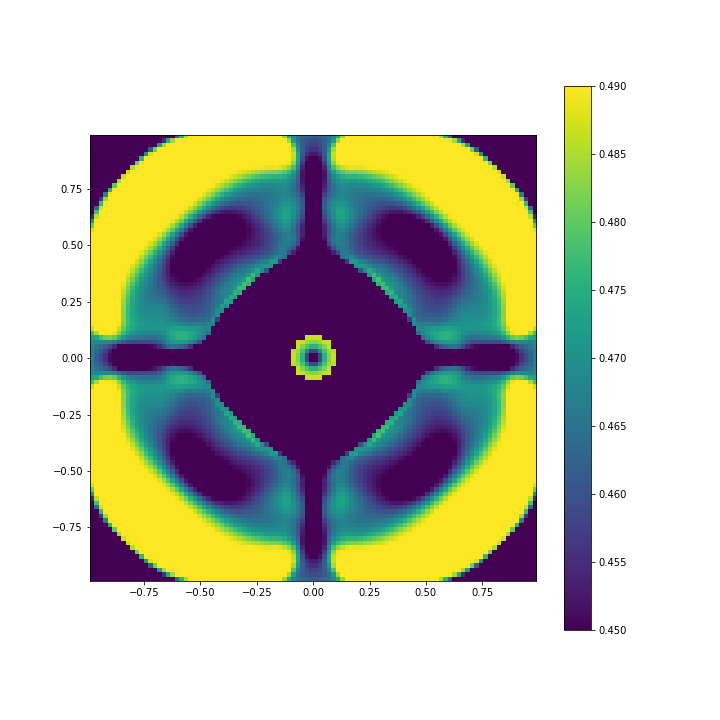
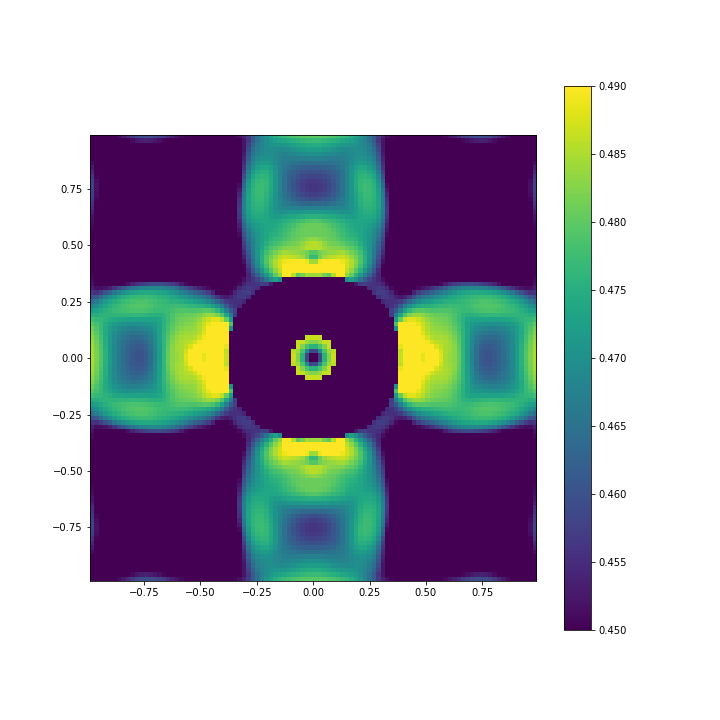
...
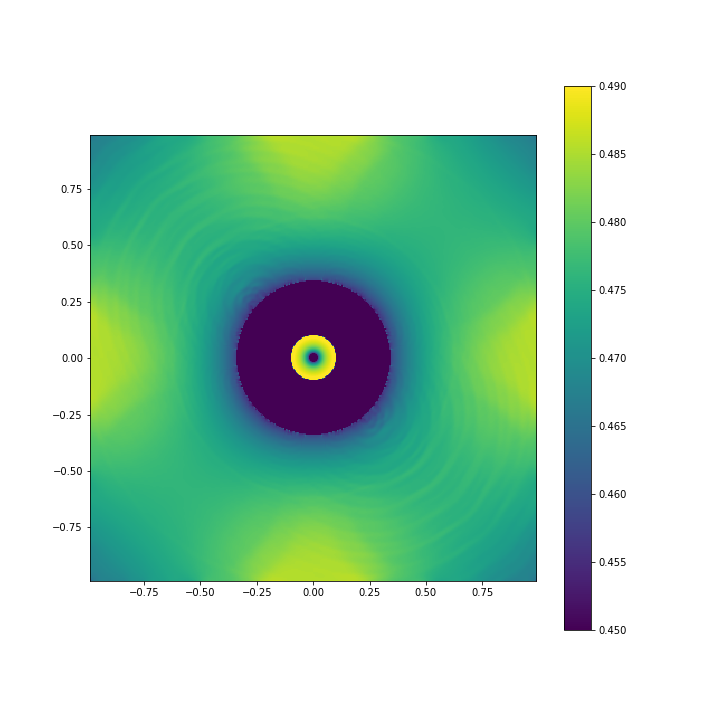
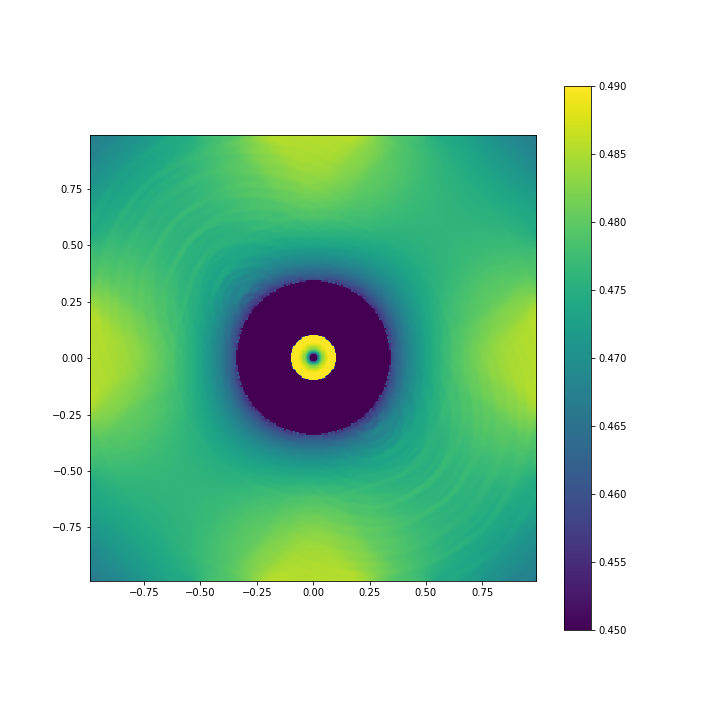
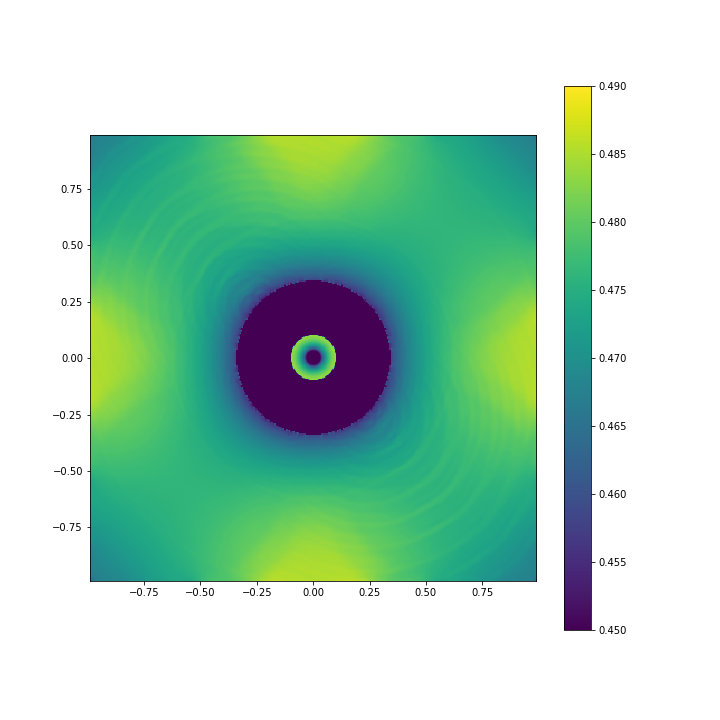
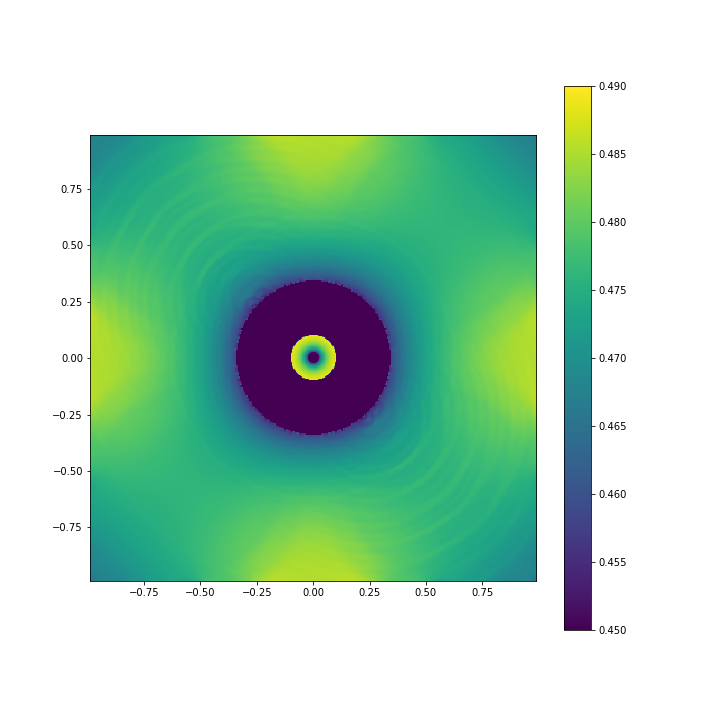
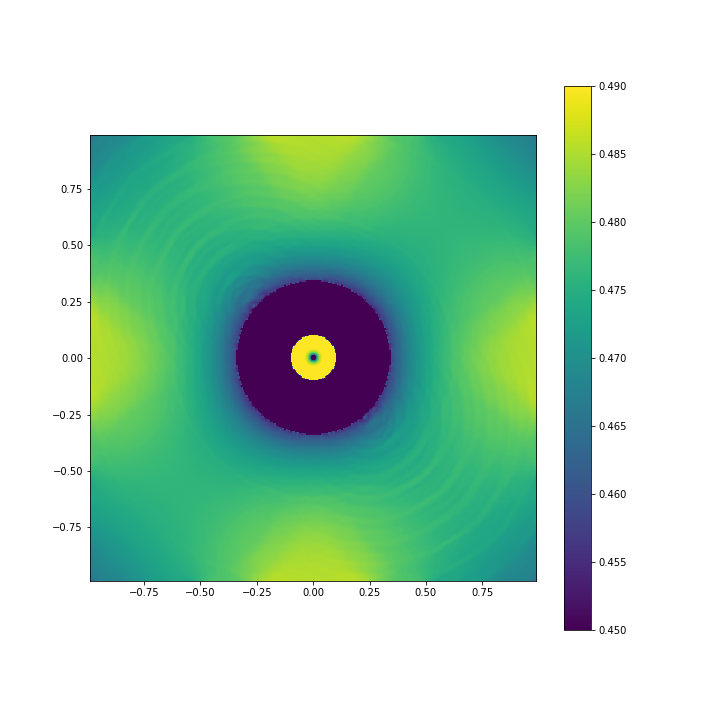

In [5]:
plot_surface(claw,frames=101,val='surface',clim=(0.45,0.49))

In [6]:
len(claw.frames)

0

2018-11-20 18:55:46,804 INFO CLAW: Animation.save using <class 'clawpack.visclaw.JSAnimation.html_writer.HTMLWriter'>



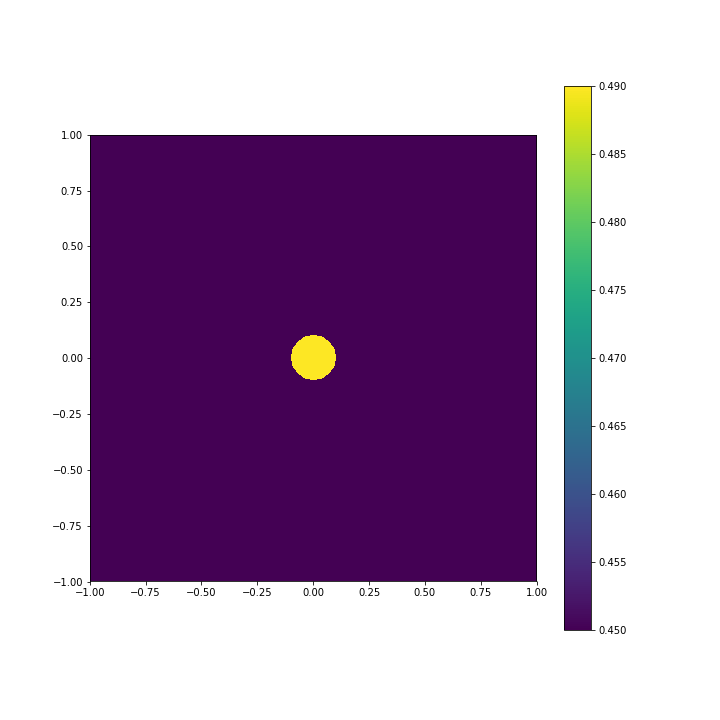
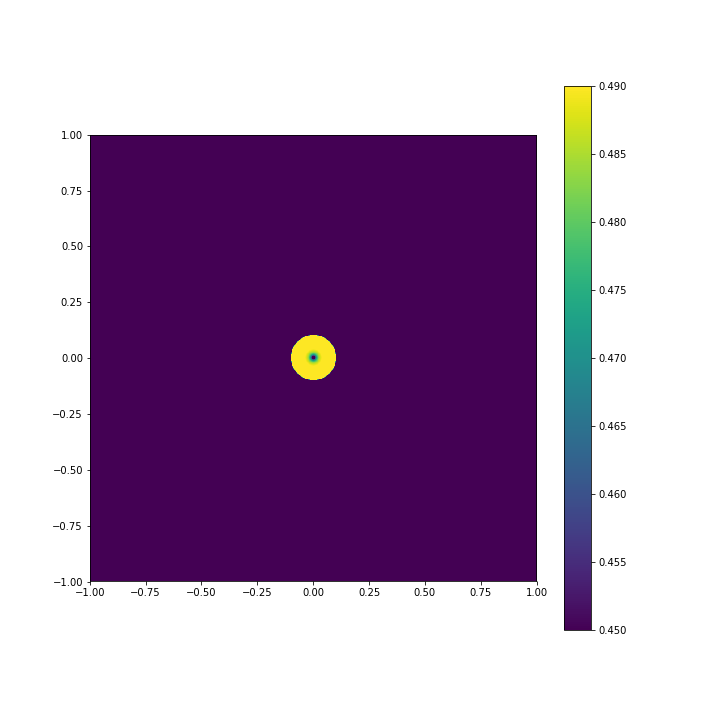
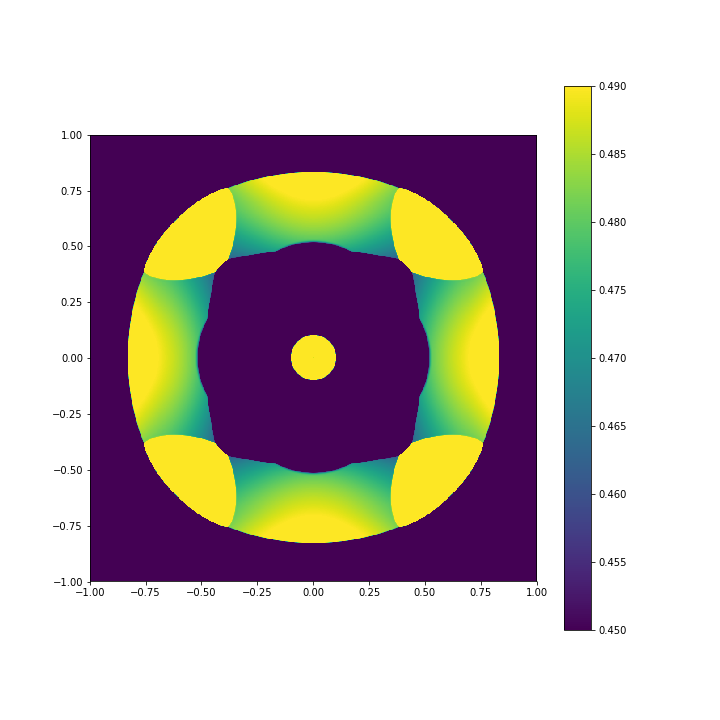
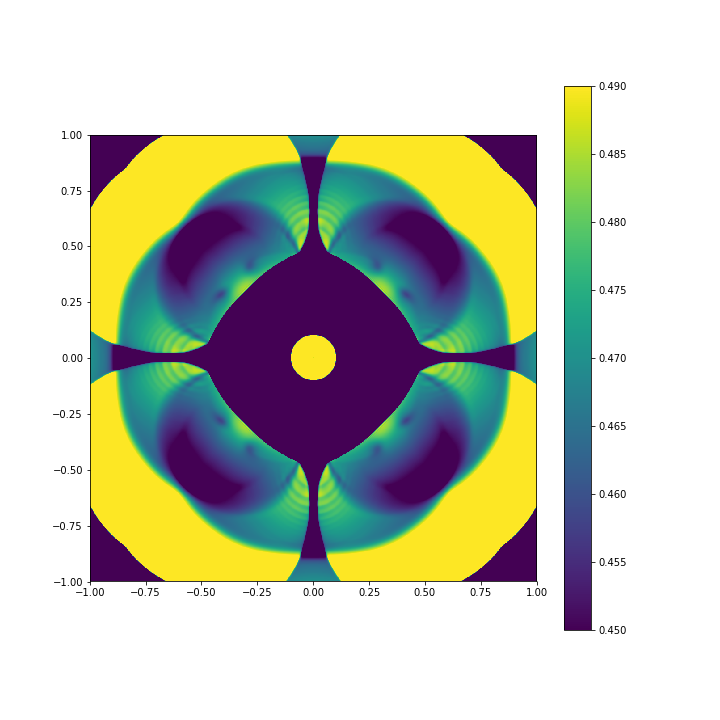
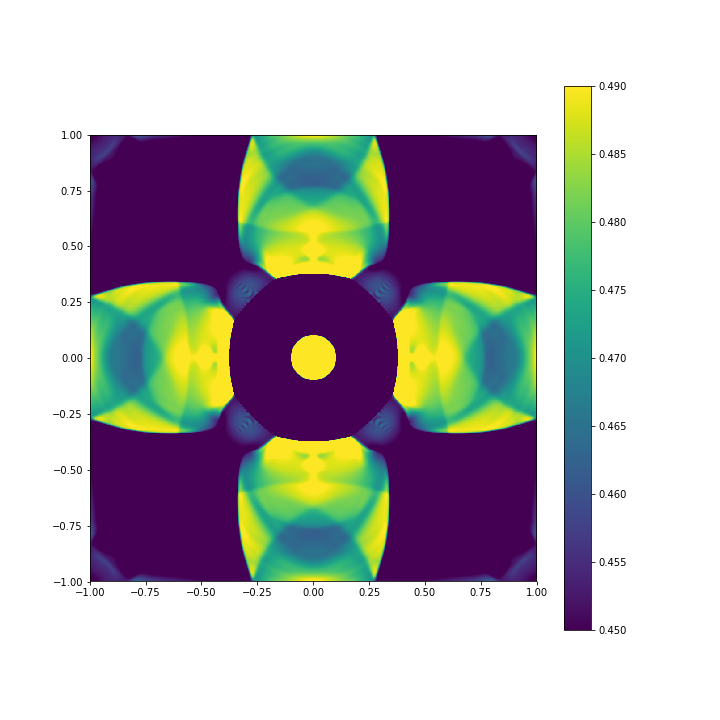
...
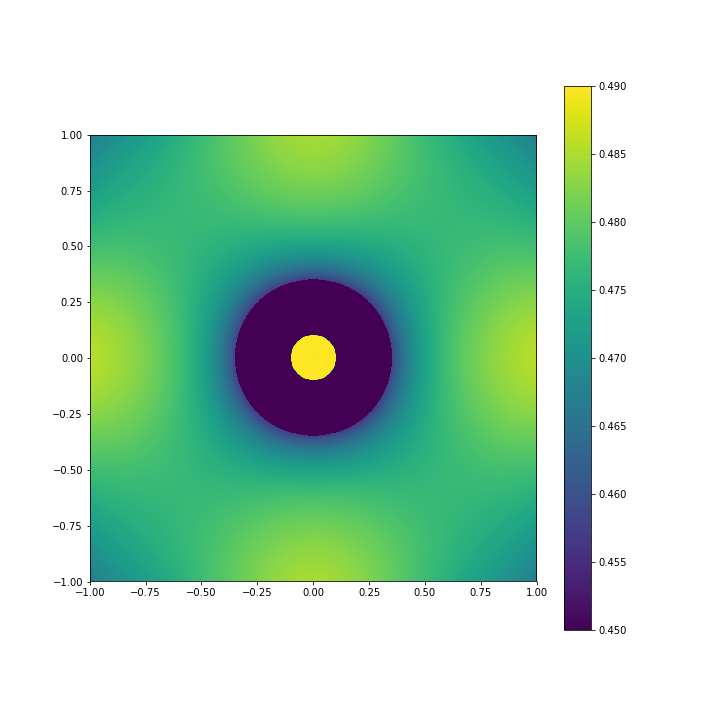
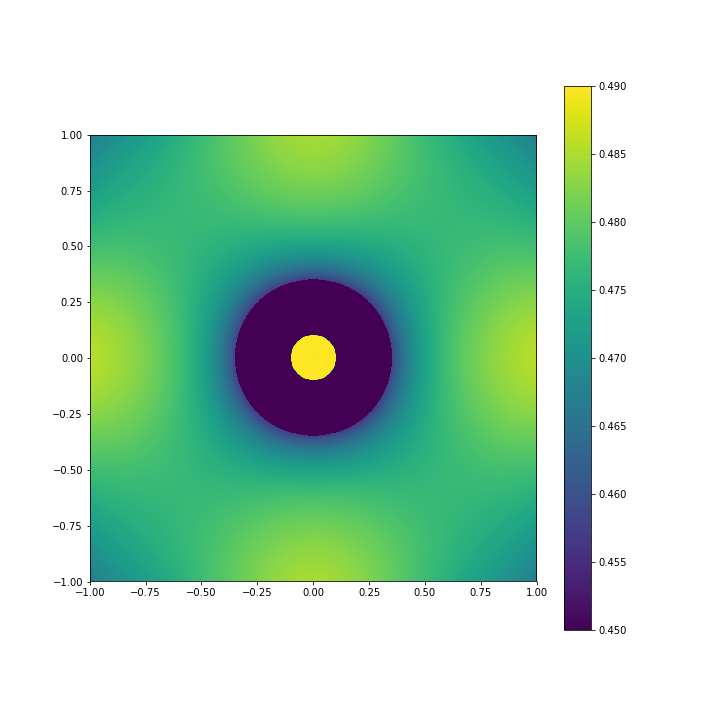
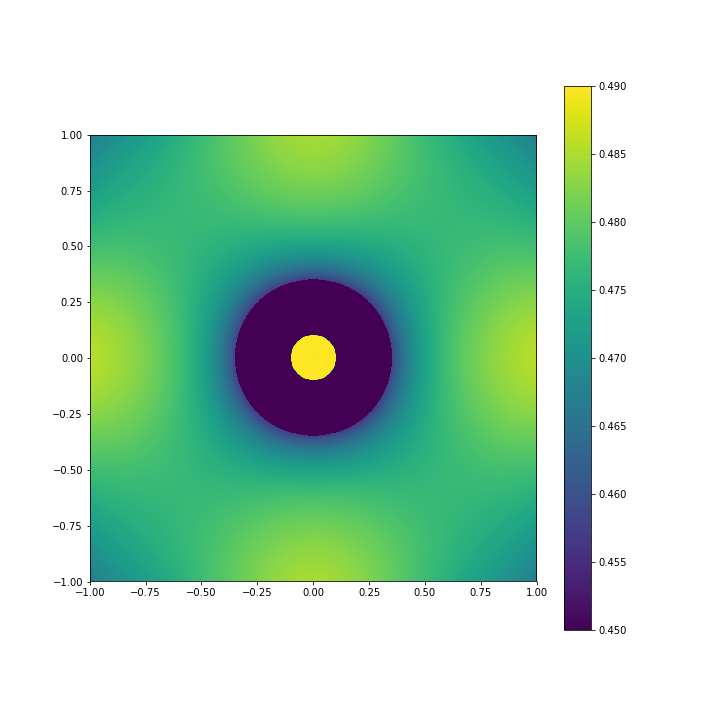
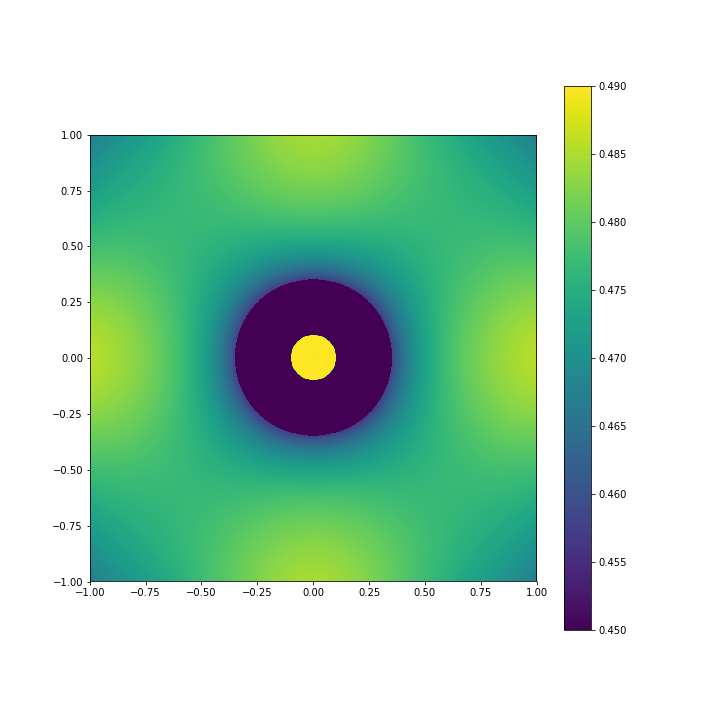
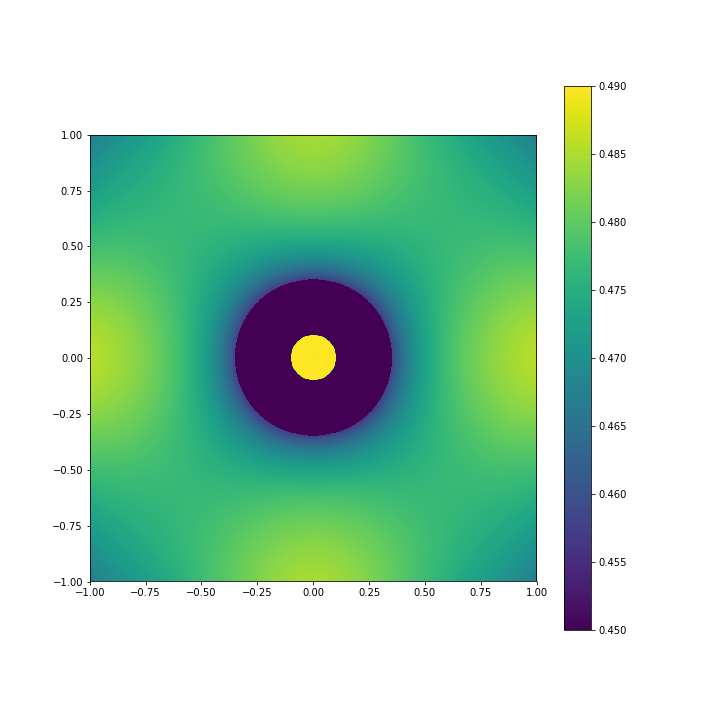

In [117]:
plot_surface(claw,frames=101,val='surface',clim=(0.45,0.49))

2018-11-21 09:38:38,083 INFO CLAW: Animation.save using <class 'clawpack.visclaw.JSAnimation.html_writer.HTMLWriter'>



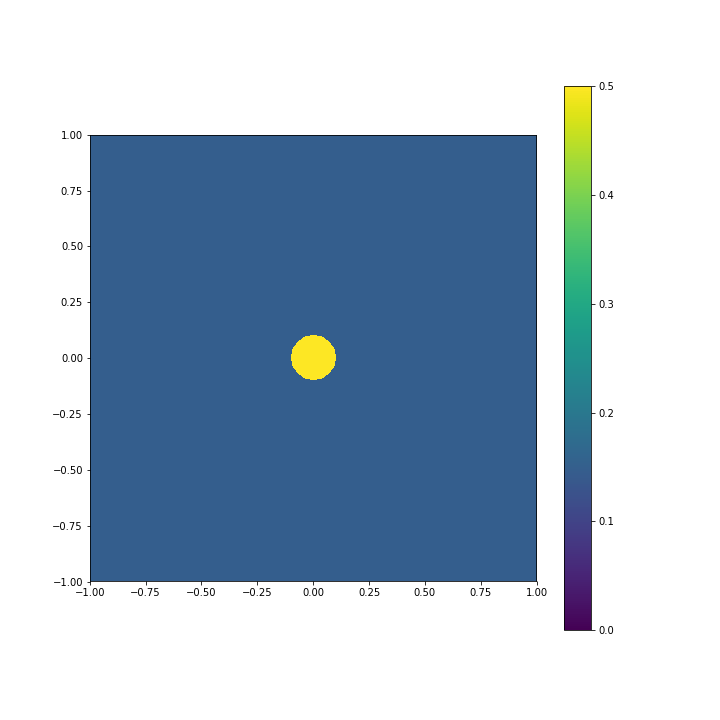
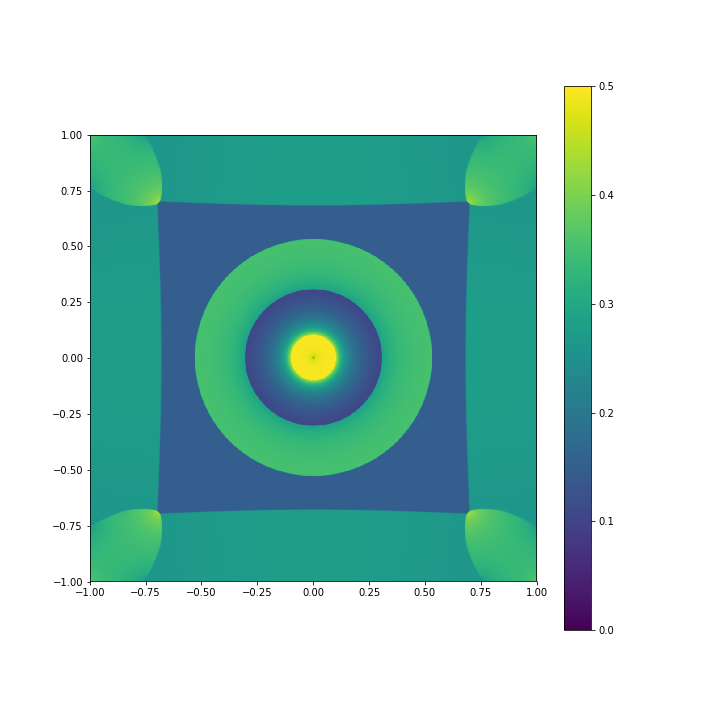
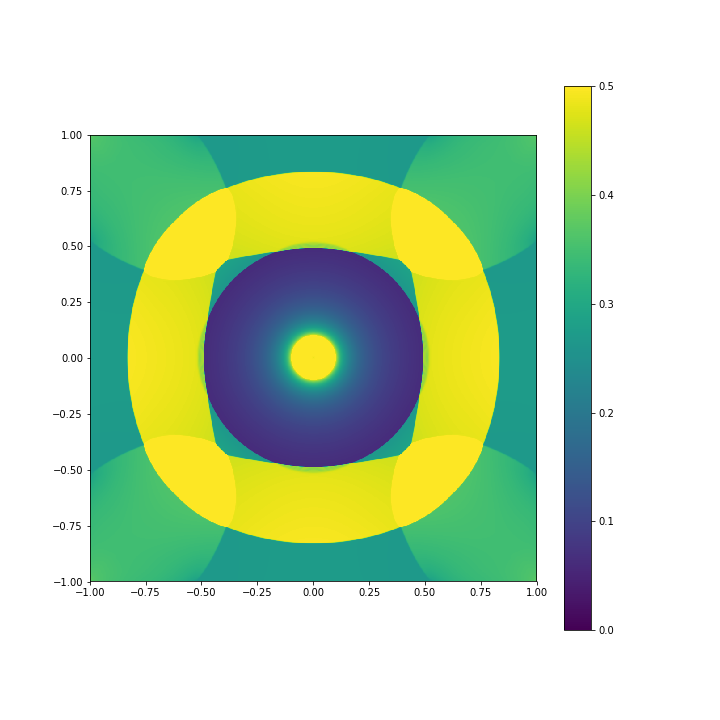
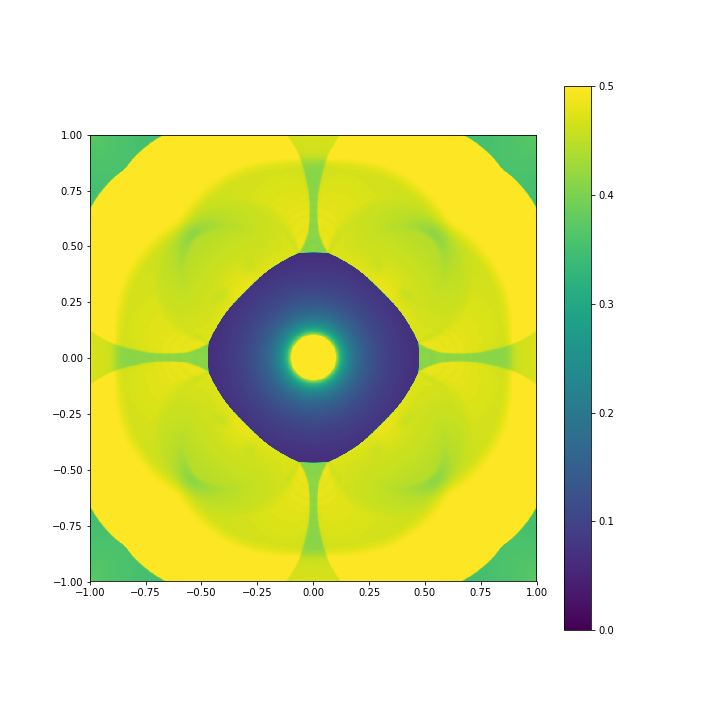
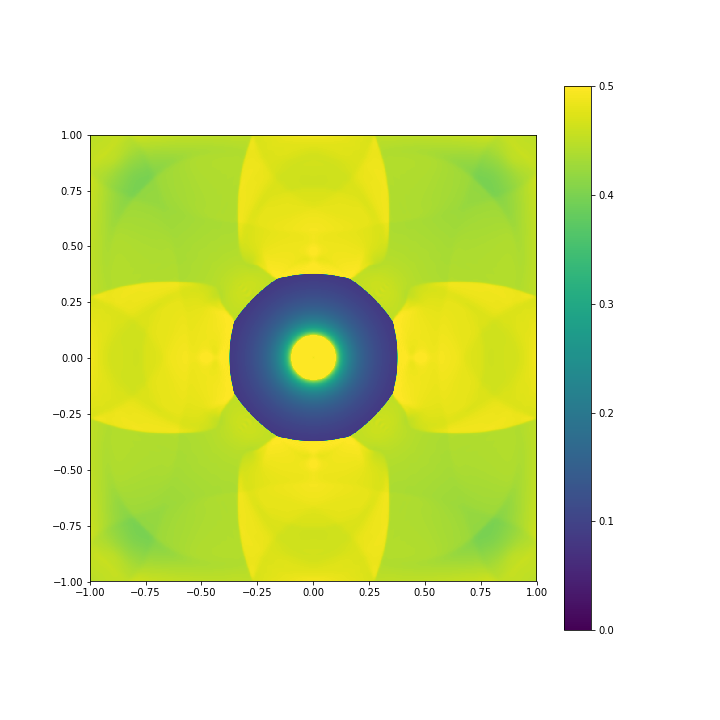
...
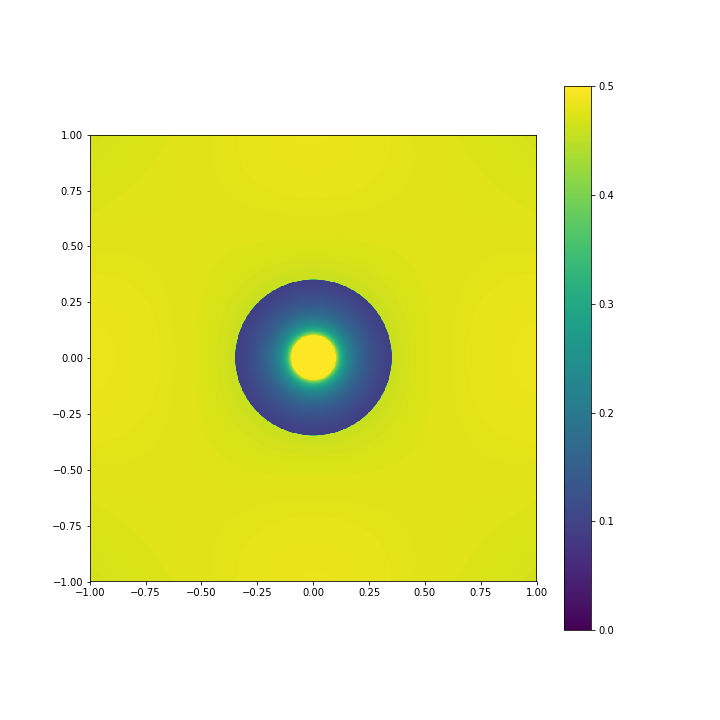
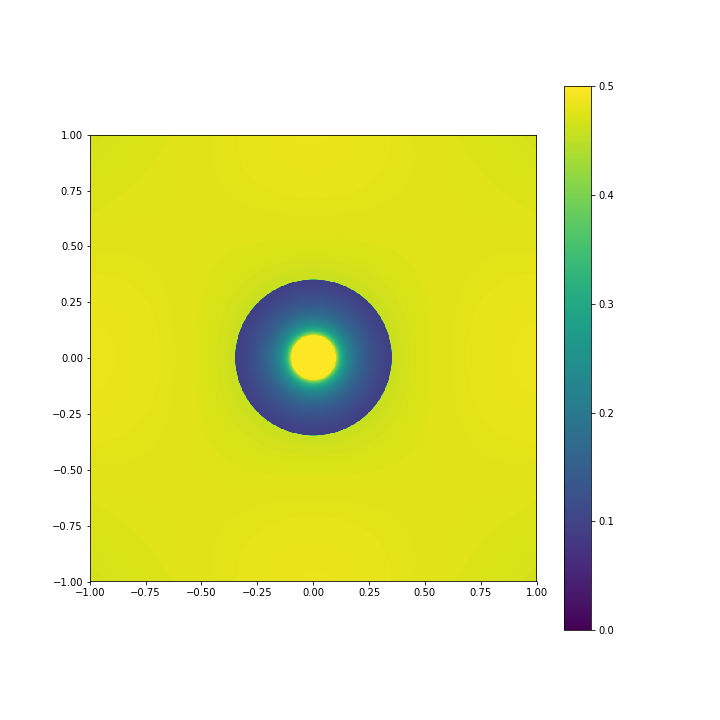
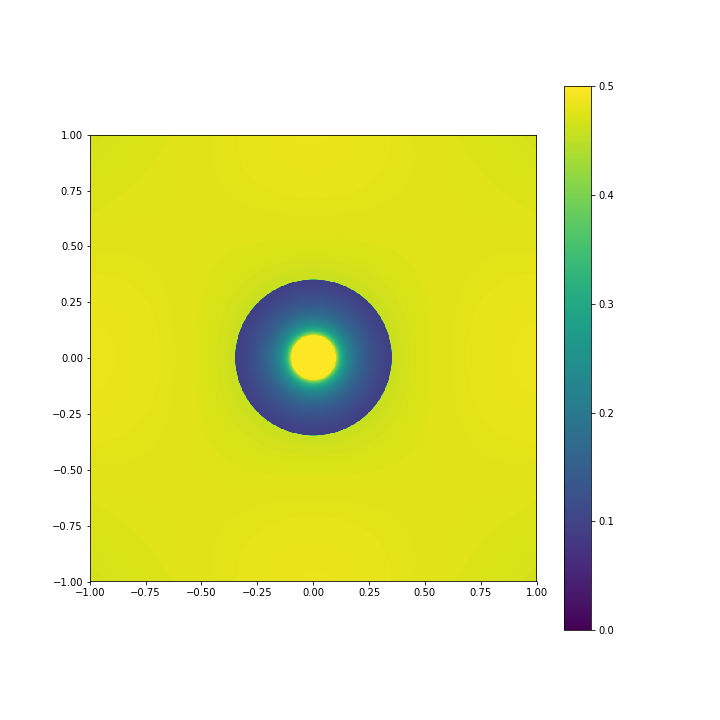
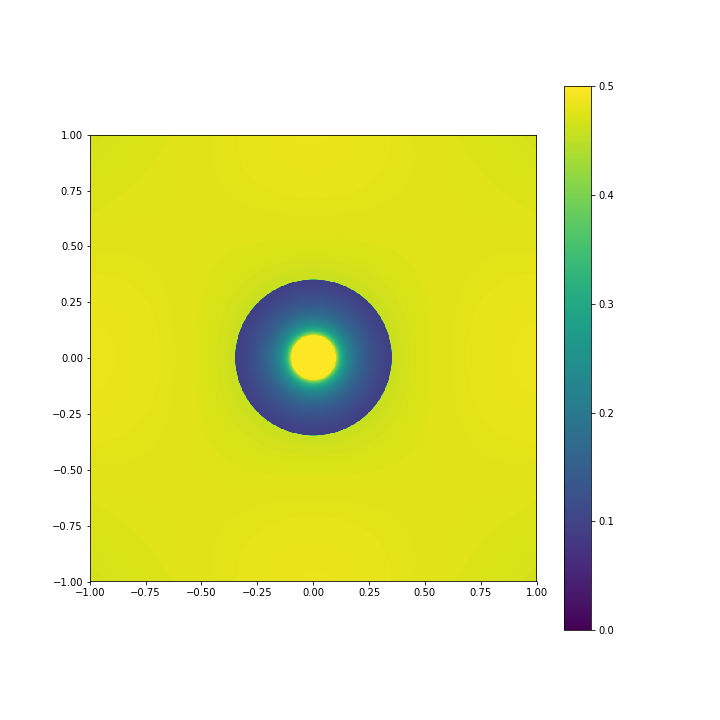
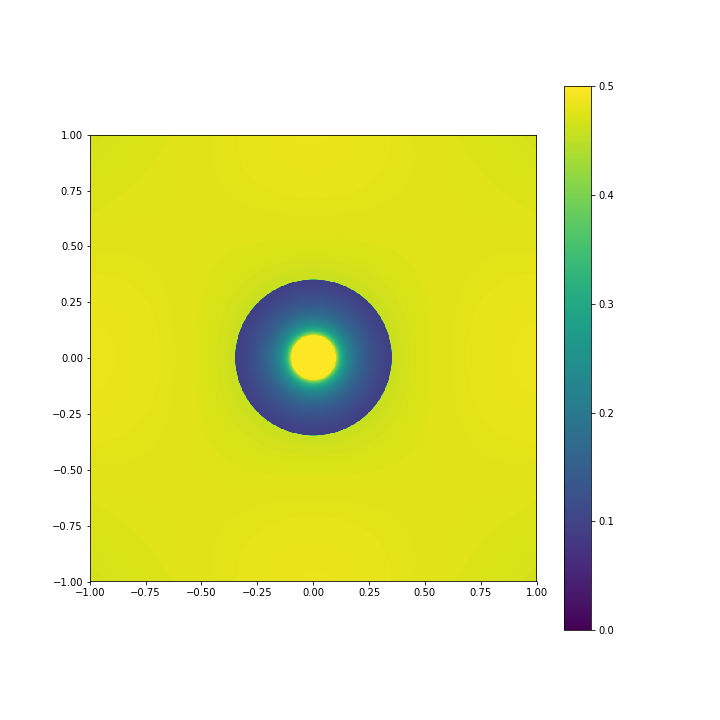

In [118]:
# 1000x1000 HLLE classic
plot_surface(claw,frames=101,val='surface')

In [98]:
claw_aug = setup(0.5,0.75,tfinal=50,num_output_times=100,num_cells=100,solver_type='classic',
             riemann_solver='aug')
claw_aug.verbosity=0
claw_aug.run()

{'cflmax': 0.8068902351938001,
 'dtmin': 0.0058821589947546426,
 'dtmax': 0.011015348270457921,
 'numsteps': 4800}


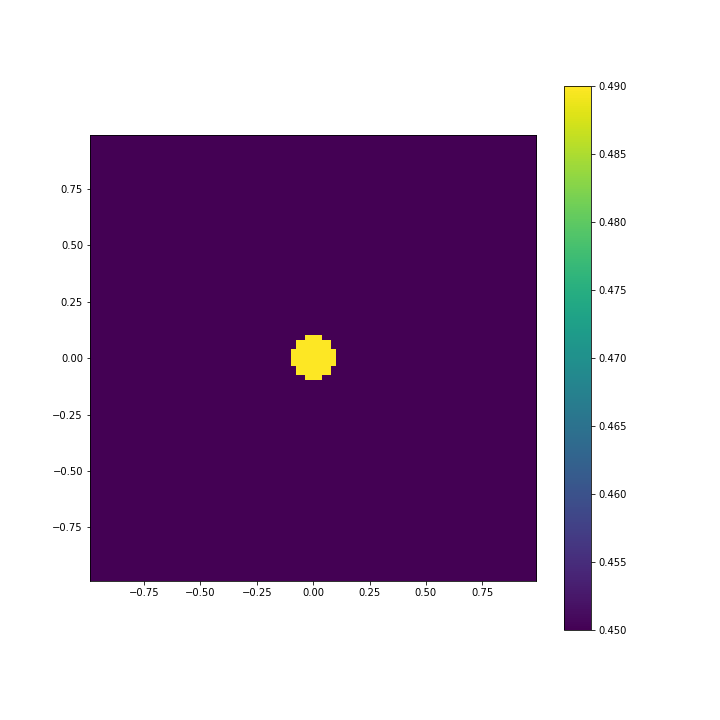
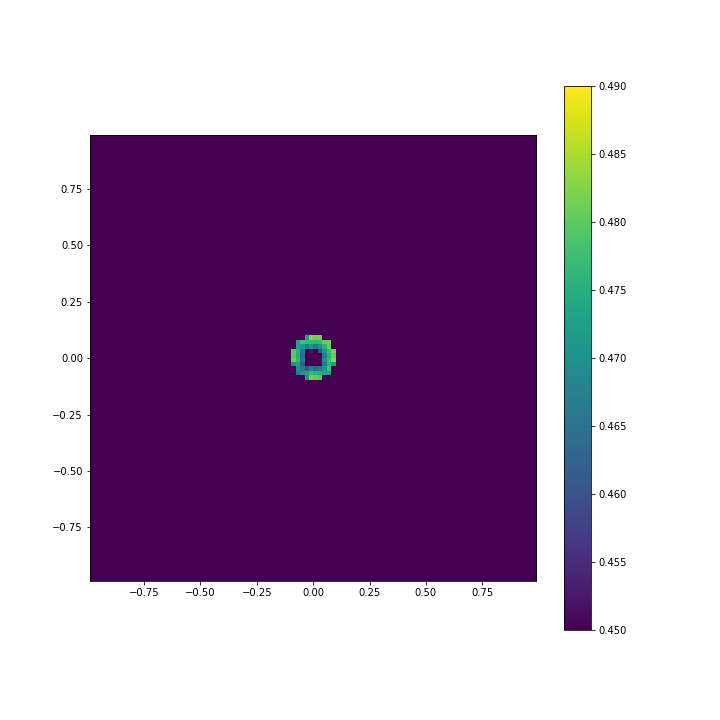
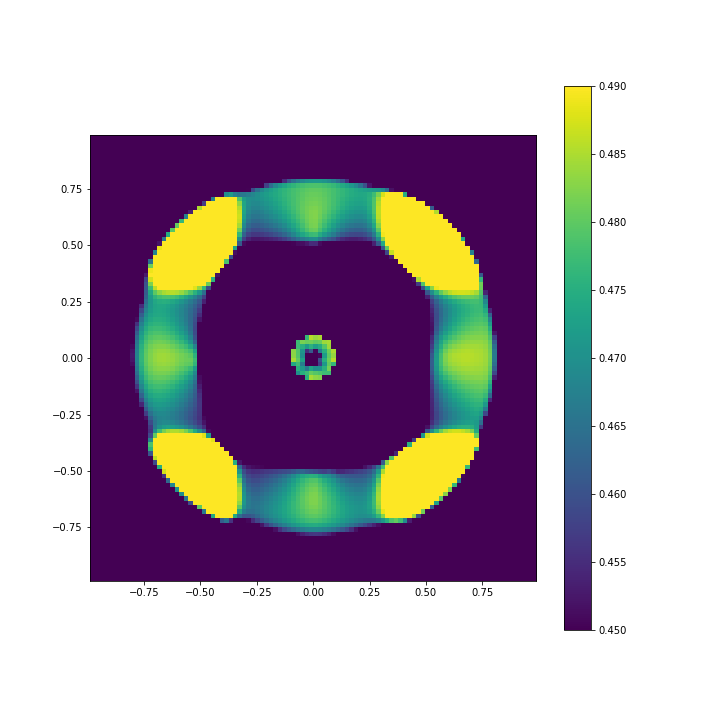
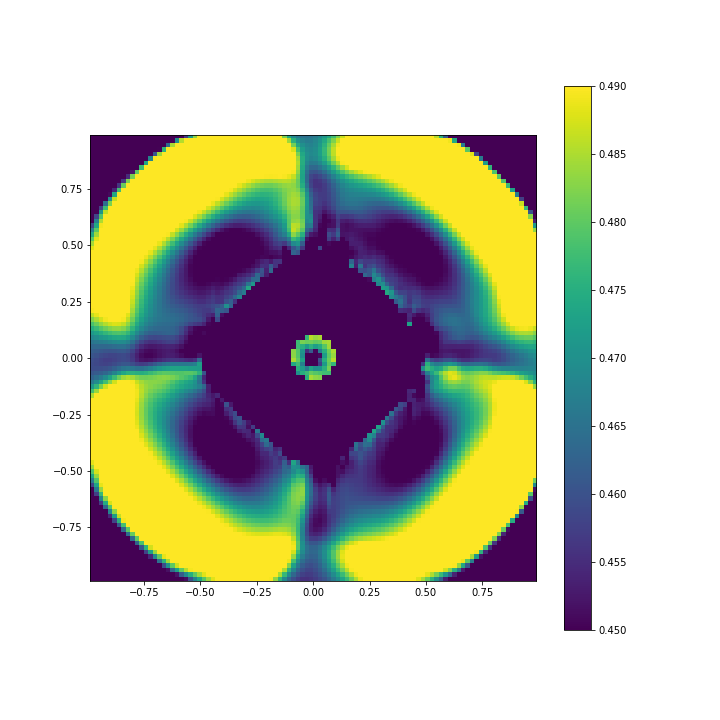
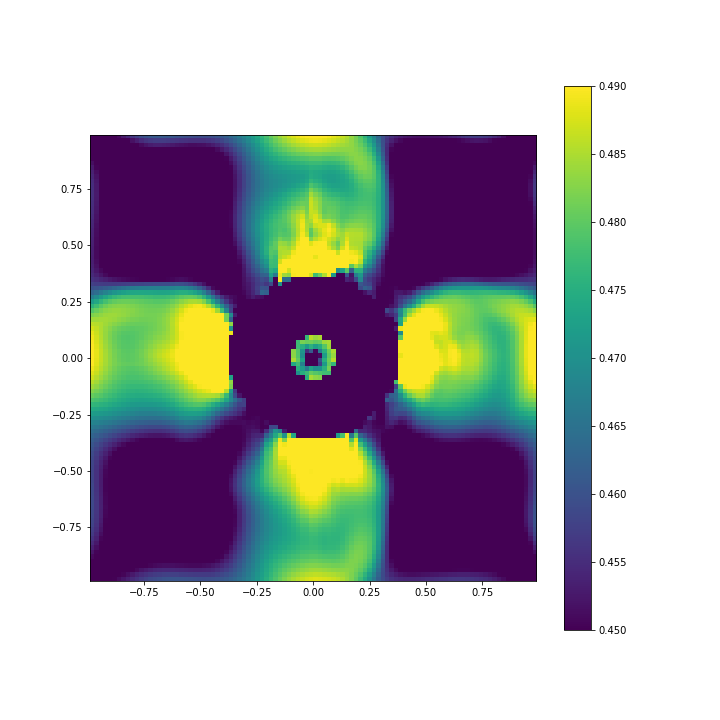
...
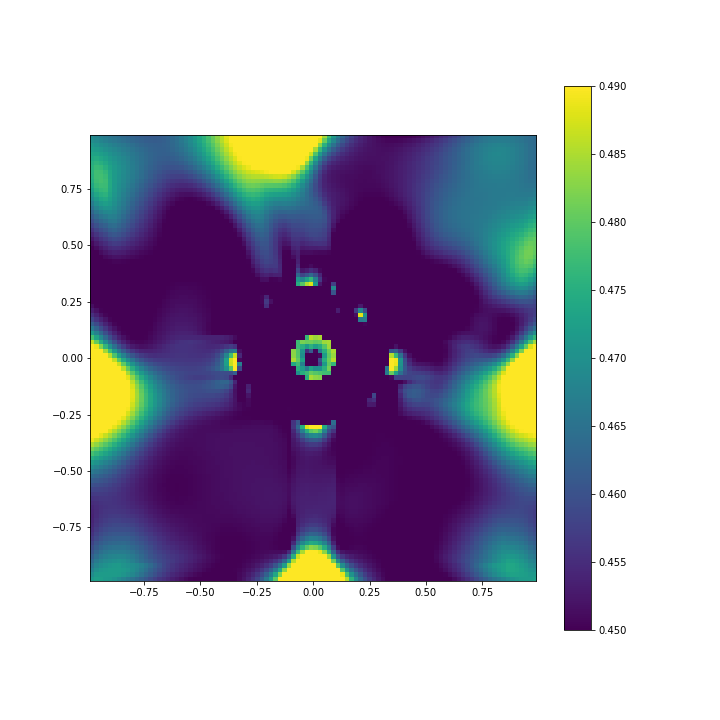
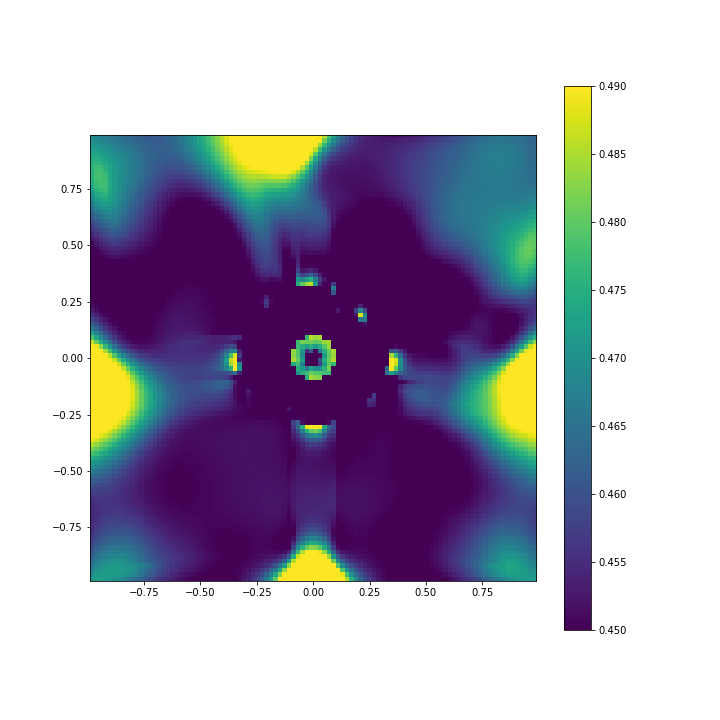
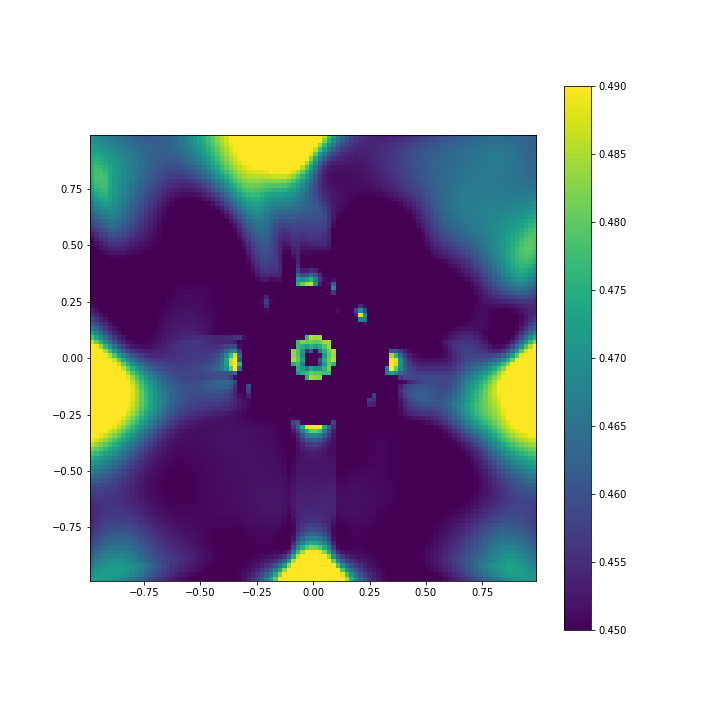
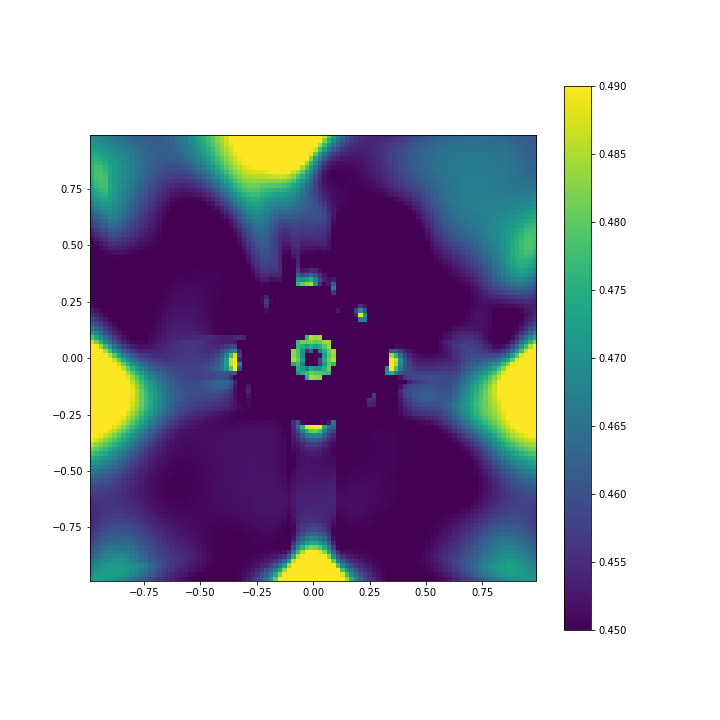
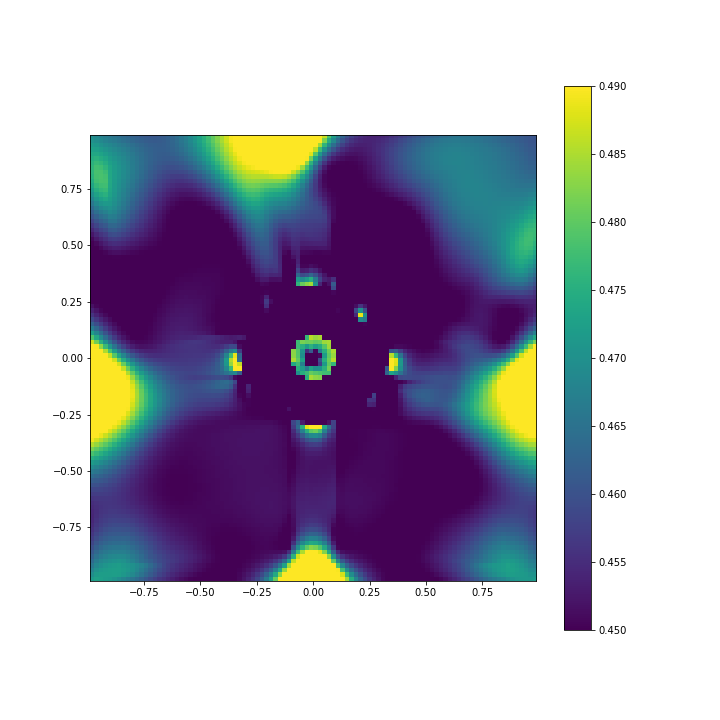

In [106]:
plot_surface(claw_aug,frames=101,val='surface')

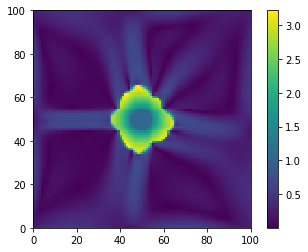

In [105]:
g = 1.
h = claw_aug.frames[-1].q[0,:,:]
u = claw_aug.frames[-1].q[1,:,:]/h
v = claw_aug.frames[-1].q[2,:,:]/h
F = np.sqrt(u**2+v**2)/np.sqrt(g*h)
plt.pcolor(F)
plt.axis('image')
plt.colorbar()

In [77]:
print(np.max(F))

3.783244056372706


(0.0, 200.0, 0.0, 200.0)

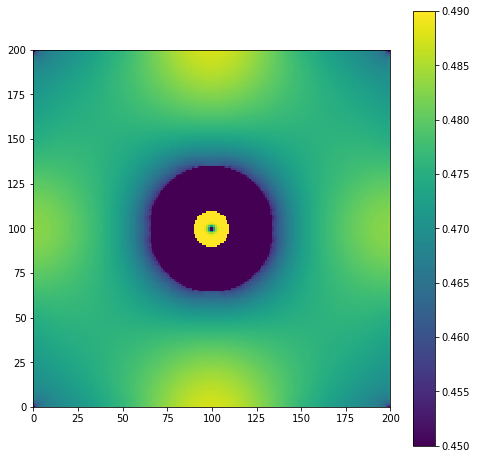

In [87]:
plt.figure(figsize=(8,8))
plt.pcolor(h)
plt.clim(0.45,0.49)
plt.colorbar()
plt.axis('image')

In [115]:
len(claw.frames)

0